## App Nation Case Study

**Author**: Mert Acar\
**Date**: 15.01.2025


### Data Generation

In [ ]:
!pip install lpips mediapipe segmentation-models-pytorch

  Preparing metadata (setup.py) ... done
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 58.8/58.8 kB 4.6 MB/s eta 0:00:00
  Preparing metadata (setup.py) ... done
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 53.8/53.8 kB 4.9 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 35.6/35.6 MB 62.7 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 121.3/121.3 kB 10.0 MB/s eta 0:00:00
  Created wheel for efficientnet-pytorch: filename=efficientnet_pytorch-0.7.1-py3-none-any.whl size=16424 sha256=2b0213c101177426ca874818ea31a5b54dbf816f327438cceba979f605b9d813
  Stored in directory: /root/.cache/pip/wheels/8b/6f/9b/231a832f811ab6ebb1b32455b177ffc6b8b1cd8de19de70c09
  Created wheel for pretrainedmodels: filename=pretrainedmodels-0.7.4-py3-none-any.whl size=60944 sha256=fb4df663d56d6fef3c3da2cb4bdbbf4aa8111cedffbb97add87a6c7ff93d76ad
  Stored in directory: /root/.cache/pip/wheels/5f/5b/96/fd94bc35962d7c6b699e8814db545155ac91d2b95785e1b035
Successfully built efficientnet-pytorc

In [1]:
from google.colab import drive
drive.mount('/content/drive')

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


In [2]:
import os
import sys
sys.path.insert(0, "/content/drive/MyDrive/AppNation_CaseStudy/src/")

import torch
from tqdm import tqdm
from PIL import Image

In [3]:
from shutil import copyfile
from test import test_model
from train import train_model
from visualize import side_by_side
from utils import get_image_pairs, train_test_split
from generate import BeardMaskGenerator, setup_pipelines

/usr/local/lib/python3.11/dist-packages/albumentations/__init__.py:24: UserWarning: A new version of Albumentations is available: 2.0.0 (you have 1.4.20). Upgrade using: pip install -U albumentations. To disable automatic update checks, set the environment variable NO_ALBUMENTATIONS_UPDATE to 1.
  check_for_updates()


In [4]:
device = torch.device("cuda")

In [5]:
data_dir = "/content/drive/MyDrive/AppNation_CaseStudy/dataset/processed/"

In [ ]:
mask_generator = BeardMaskGenerator()

In [ ]:
base_pipe, inpaint_pipe = setup_pipelines(device=device)

In [ ]:
output_dir = "/content/drive/MyDrive/AppNation_CaseStudy/dataset/raw/"
num_pairs = 200
base_seed = 9001
os.makedirs(output_dir, exist_ok=True)

In [ ]:
base_prompt = "professional headshot portrait of a person, male, high quality, detailed, shoulders-up, no smile, whole face in the frame"
negative_prompt = "low quality, blurry, bad anatomy, bad proportions, deformed face, unnatural eyes, teeth, smile, happy"

In [ ]:
diffusion_config = {
  "base_pipe": {
    "num_inference_steps": 75,
    "guidance_scale": 7.5
  },
  "inpaint_pipe": {
    "num_inference_steps": 100,
    "strength": 0.8
  }
}
for i in tqdm(range(num_pairs), desc="Generating pairs:"):
  curr_seed = base_seed + (i * 1000)
  generator = torch.Generator("cuda").manual_seed(curr_seed)
  clean_image = base_pipe(
    prompt=f"{base_prompt}, clean-shaven, smooth face",
    negative_prompt=f"{negative_prompt}, facial hair, beard, stubble",
    generator=generator,
    **diffusion_config["base_pipe"]
  ).images[0]
  clean_image.save(os.path.join(output_dir, f"clean_{i}.png"))

  mask = mask_generator.get_mask(clean_image)
  generator = torch.Generator("cuda").manual_seed(curr_seed)
  bearded_image = inpaint_pipe(
    prompt=f"{base_prompt}, with thick full beard, dense facial hair, well-groomed beard, detailed beard texture, same face, no structural change, same person, do not change mouth",
    image=clean_image,
    mask_image=mask,
    negative_prompt=f"{negative_prompt}, clean-shaven, no facial hair",
    generator=generator,
    **diffusion_config["inpaint_pipe"]
  ).images[0]
  bearded_image.save(os.path.join(output_dir, f"bearded_{i}.png"))

### Train-Test Split

In [ ]:
filelist = get_image_pairs(output_dir)
train, test = train_test_split(datalist=filelist, train_size=0.85)

In [ ]:
train_dir, test_dir = os.path.join(data_dir, "train"), os.path.join(data_dir, "test")
os.makedirs(train_dir, exist_ok=True)
for i, (clean, bearded) in enumerate(train):
  copyfile(os.path.join(output_dir, clean), os.path.join(train_dir, f"clean_{i}.png"))
  copyfile(os.path.join(output_dir, bearded), os.path.join(train_dir, f"bearded_{i}.png"))

os.makedirs(test_dir, exist_ok=True)
for i, (clean, bearded) in enumerate(test):
  copyfile(os.path.join(output_dir, clean), os.path.join(test_dir, f"clean_{i}.png"))
  copyfile(os.path.join(output_dir, bearded), os.path.join(test_dir, f"bearded_{i}.png"))

##### Sample Generated Images

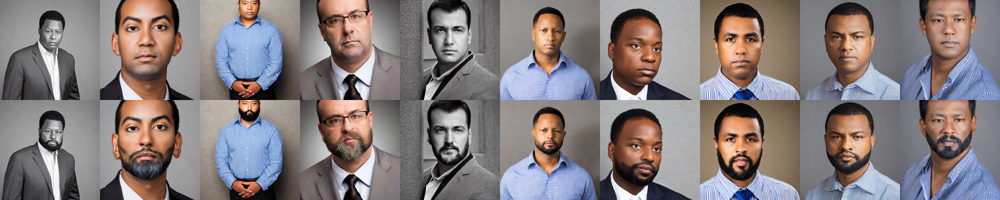

In [ ]:
clean_images = side_by_side([Image.open(os.path.join(output_dir, pair[0])) for pair in test[:10]], 1)
bearded_images = side_by_side([Image.open(os.path.join(output_dir, pair[1])) for pair in test[:10]], 1)
combined = side_by_side([clean_images, bearded_images], 0)
combined

### Model Training

Output path /content/drive/MyDrive/AppNation_CaseStudy/models/experiment3/ is not empty! Do you want to delete the folder [y / n]: y
[INFO] Running on cuda
Setting up [LPIPS] perceptual loss: trunk [vgg], v[0.1], spatial [off]


/usr/local/lib/python3.11/dist-packages/torchvision/models/_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=VGG16_Weights.IMAGENET1K_V1`. You can also use `weights=VGG16_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)
/usr/local/lib/python3.11/dist-packages/lpips/lpips.py:107: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-mod

Loading model from: /usr/local/lib/python3.11/dist-packages/lpips/weights/v0.1/vgg.pth
--------------------
Epoch 1 / 300


100%|█████████████████████████████████████████████████████████| 31/31 [00:12<00:00,  2.48it/s]


Loss: 1.072
ssim: 0.573
psnr: 16.592


100%|███████████████████████████████████████████████████████████| 6/6 [00:02<00:00,  2.82it/s]


Loss: 1.249
ssim: 0.604
psnr: 13.751
+ Saving the model to /content/drive/MyDrive/AppNation_CaseStudy/models/experiment3/checkpoint.pt...
--------------------
Epoch 2 / 300


100%|█████████████████████████████████████████████████████████| 31/31 [00:11<00:00,  2.63it/s]


Loss: 0.757
ssim: 0.660
psnr: 19.717


100%|███████████████████████████████████████████████████████████| 6/6 [00:02<00:00,  2.86it/s]


Loss: 1.071
ssim: 0.638
psnr: 15.875
+ Saving the model to /content/drive/MyDrive/AppNation_CaseStudy/models/experiment3/checkpoint.pt...
--------------------
Epoch 3 / 300


100%|█████████████████████████████████████████████████████████| 31/31 [00:11<00:00,  2.62it/s]


Loss: 0.709
ssim: 0.675
psnr: 20.502


100%|███████████████████████████████████████████████████████████| 6/6 [00:02<00:00,  2.83it/s]


Loss: 1.040
ssim: 0.643
psnr: 16.105
+ Saving the model to /content/drive/MyDrive/AppNation_CaseStudy/models/experiment3/checkpoint.pt...
--------------------
Epoch 4 / 300


100%|█████████████████████████████████████████████████████████| 31/31 [00:11<00:00,  2.61it/s]


Loss: 0.664
ssim: 0.686
psnr: 20.898


100%|███████████████████████████████████████████████████████████| 6/6 [00:02<00:00,  2.82it/s]


Loss: 0.984
ssim: 0.655
psnr: 16.510
+ Saving the model to /content/drive/MyDrive/AppNation_CaseStudy/models/experiment3/checkpoint.pt...
--------------------
Epoch 5 / 300


100%|█████████████████████████████████████████████████████████| 31/31 [00:12<00:00,  2.48it/s]


Loss: 0.698
ssim: 0.681
psnr: 20.400


100%|███████████████████████████████████████████████████████████| 6/6 [00:02<00:00,  2.83it/s]


Loss: 0.984
ssim: 0.651
psnr: 16.314
--------------------
Epoch 6 / 300


100%|█████████████████████████████████████████████████████████| 31/31 [00:12<00:00,  2.54it/s]


Loss: 0.669
ssim: 0.696
psnr: 20.895


100%|███████████████████████████████████████████████████████████| 6/6 [00:02<00:00,  2.78it/s]


Loss: 0.935
ssim: 0.661
psnr: 16.727
+ Saving the model to /content/drive/MyDrive/AppNation_CaseStudy/models/experiment3/checkpoint.pt...
--------------------
Epoch 7 / 300


100%|█████████████████████████████████████████████████████████| 31/31 [00:12<00:00,  2.48it/s]


Loss: 0.678
ssim: 0.702
psnr: 20.758


100%|███████████████████████████████████████████████████████████| 6/6 [00:02<00:00,  2.73it/s]


Loss: 0.839
ssim: 0.681
psnr: 18.146
+ Saving the model to /content/drive/MyDrive/AppNation_CaseStudy/models/experiment3/checkpoint.pt...
--------------------
Epoch 8 / 300


100%|█████████████████████████████████████████████████████████| 31/31 [00:12<00:00,  2.49it/s]


Loss: 0.640
ssim: 0.697
psnr: 21.330


100%|███████████████████████████████████████████████████████████| 6/6 [00:02<00:00,  2.78it/s]


Loss: 0.800
ssim: 0.689
psnr: 18.671
+ Saving the model to /content/drive/MyDrive/AppNation_CaseStudy/models/experiment3/checkpoint.pt...
--------------------
Epoch 9 / 300


100%|█████████████████████████████████████████████████████████| 31/31 [00:12<00:00,  2.56it/s]


Loss: 0.620
ssim: 0.687
psnr: 21.431


100%|███████████████████████████████████████████████████████████| 6/6 [00:02<00:00,  2.74it/s]


Loss: 0.690
ssim: 0.712
psnr: 20.458
+ Saving the model to /content/drive/MyDrive/AppNation_CaseStudy/models/experiment3/checkpoint.pt...
--------------------
Epoch 10 / 300


100%|█████████████████████████████████████████████████████████| 31/31 [00:12<00:00,  2.51it/s]


Loss: 0.617
ssim: 0.700
psnr: 21.534


100%|███████████████████████████████████████████████████████████| 6/6 [00:02<00:00,  2.73it/s]


Loss: 0.685
ssim: 0.703
psnr: 20.423
+ Saving the model to /content/drive/MyDrive/AppNation_CaseStudy/models/experiment3/checkpoint.pt...
--------------------
Epoch 11 / 300


100%|█████████████████████████████████████████████████████████| 31/31 [00:12<00:00,  2.53it/s]


Loss: 0.612
ssim: 0.703
psnr: 21.622


100%|███████████████████████████████████████████████████████████| 6/6 [00:02<00:00,  2.78it/s]


Loss: 0.623
ssim: 0.716
psnr: 21.506
+ Saving the model to /content/drive/MyDrive/AppNation_CaseStudy/models/experiment3/checkpoint.pt...
--------------------
Epoch 12 / 300


100%|█████████████████████████████████████████████████████████| 31/31 [00:12<00:00,  2.55it/s]


Loss: 0.624
ssim: 0.691
psnr: 21.404


100%|███████████████████████████████████████████████████████████| 6/6 [00:02<00:00,  2.87it/s]


Loss: 0.602
ssim: 0.719
psnr: 21.811
+ Saving the model to /content/drive/MyDrive/AppNation_CaseStudy/models/experiment3/checkpoint.pt...
--------------------
Epoch 13 / 300


100%|█████████████████████████████████████████████████████████| 31/31 [00:11<00:00,  2.60it/s]


Loss: 0.608
ssim: 0.692
psnr: 21.808


100%|███████████████████████████████████████████████████████████| 6/6 [00:02<00:00,  2.85it/s]


Loss: 0.565
ssim: 0.724
psnr: 22.743
+ Saving the model to /content/drive/MyDrive/AppNation_CaseStudy/models/experiment3/checkpoint.pt...
--------------------
Epoch 14 / 300


100%|█████████████████████████████████████████████████████████| 31/31 [00:11<00:00,  2.67it/s]


Loss: 0.607
ssim: 0.697
psnr: 21.575


100%|███████████████████████████████████████████████████████████| 6/6 [00:02<00:00,  2.80it/s]


Loss: 0.625
ssim: 0.714
psnr: 20.866
--------------------
Epoch 15 / 300


100%|█████████████████████████████████████████████████████████| 31/31 [00:11<00:00,  2.61it/s]


Loss: 0.604
ssim: 0.691
psnr: 21.559


100%|███████████████████████████████████████████████████████████| 6/6 [00:02<00:00,  2.75it/s]


Loss: 0.530
ssim: 0.736
psnr: 23.099
+ Saving the model to /content/drive/MyDrive/AppNation_CaseStudy/models/experiment3/checkpoint.pt...
--------------------
Epoch 16 / 300


100%|█████████████████████████████████████████████████████████| 31/31 [00:12<00:00,  2.57it/s]


Loss: 0.608
ssim: 0.702
psnr: 21.587


100%|███████████████████████████████████████████████████████████| 6/6 [00:02<00:00,  2.83it/s]


Loss: 0.549
ssim: 0.732
psnr: 22.600
--------------------
Epoch 17 / 300


100%|█████████████████████████████████████████████████████████| 31/31 [00:12<00:00,  2.57it/s]


Loss: 0.595
ssim: 0.696
psnr: 21.747


100%|███████████████████████████████████████████████████████████| 6/6 [00:02<00:00,  2.80it/s]


Loss: 0.524
ssim: 0.735
psnr: 23.182
+ Saving the model to /content/drive/MyDrive/AppNation_CaseStudy/models/experiment3/checkpoint.pt...
--------------------
Epoch 18 / 300


100%|█████████████████████████████████████████████████████████| 31/31 [00:12<00:00,  2.54it/s]


Loss: 0.599
ssim: 0.698
psnr: 21.897


100%|███████████████████████████████████████████████████████████| 6/6 [00:02<00:00,  2.76it/s]


Loss: 0.492
ssim: 0.736
psnr: 23.847
+ Saving the model to /content/drive/MyDrive/AppNation_CaseStudy/models/experiment3/checkpoint.pt...
--------------------
Epoch 19 / 300


100%|█████████████████████████████████████████████████████████| 31/31 [00:12<00:00,  2.50it/s]


Loss: 0.574
ssim: 0.680
psnr: 22.150


100%|███████████████████████████████████████████████████████████| 6/6 [00:02<00:00,  2.72it/s]


Loss: 0.495
ssim: 0.745
psnr: 23.412
--------------------
Epoch 20 / 300


100%|█████████████████████████████████████████████████████████| 31/31 [00:12<00:00,  2.50it/s]


Loss: 0.545
ssim: 0.710
psnr: 22.545


100%|███████████████████████████████████████████████████████████| 6/6 [00:02<00:00,  2.77it/s]


Loss: 0.491
ssim: 0.741
psnr: 23.736
+ Saving the model to /content/drive/MyDrive/AppNation_CaseStudy/models/experiment3/checkpoint.pt...
--------------------
Epoch 21 / 300


100%|█████████████████████████████████████████████████████████| 31/31 [00:12<00:00,  2.51it/s]


Loss: 0.565
ssim: 0.695
psnr: 22.112


100%|███████████████████████████████████████████████████████████| 6/6 [00:02<00:00,  2.73it/s]


Loss: 0.505
ssim: 0.738
psnr: 22.410
--------------------
Epoch 22 / 300


100%|█████████████████████████████████████████████████████████| 31/31 [00:12<00:00,  2.58it/s]


Loss: 0.548
ssim: 0.693
psnr: 22.529


100%|███████████████████████████████████████████████████████████| 6/6 [00:02<00:00,  2.79it/s]


Loss: 0.489
ssim: 0.736
psnr: 23.804
+ Saving the model to /content/drive/MyDrive/AppNation_CaseStudy/models/experiment3/checkpoint.pt...
--------------------
Epoch 23 / 300


100%|█████████████████████████████████████████████████████████| 31/31 [00:12<00:00,  2.46it/s]


Loss: 0.540
ssim: 0.711
psnr: 22.611


100%|███████████████████████████████████████████████████████████| 6/6 [00:02<00:00,  2.74it/s]


Loss: 0.508
ssim: 0.738
psnr: 23.565
--------------------
Epoch 24 / 300


100%|█████████████████████████████████████████████████████████| 31/31 [00:12<00:00,  2.52it/s]


Loss: 0.559
ssim: 0.710
psnr: 22.409


100%|███████████████████████████████████████████████████████████| 6/6 [00:02<00:00,  2.78it/s]


Loss: 0.590
ssim: 0.726
psnr: 21.484
--------------------
Epoch 25 / 300


100%|█████████████████████████████████████████████████████████| 31/31 [00:12<00:00,  2.54it/s]


Loss: 0.545
ssim: 0.700
psnr: 22.612


100%|███████████████████████████████████████████████████████████| 6/6 [00:02<00:00,  2.76it/s]


Loss: 0.503
ssim: 0.734
psnr: 23.503
--------------------
Epoch 26 / 300


100%|█████████████████████████████████████████████████████████| 31/31 [00:12<00:00,  2.47it/s]


Loss: 0.545
ssim: 0.708
psnr: 22.710


100%|███████████████████████████████████████████████████████████| 6/6 [00:02<00:00,  2.76it/s]


Loss: 0.486
ssim: 0.742
psnr: 23.511
+ Saving the model to /content/drive/MyDrive/AppNation_CaseStudy/models/experiment3/checkpoint.pt...
--------------------
Epoch 27 / 300


100%|█████████████████████████████████████████████████████████| 31/31 [00:12<00:00,  2.45it/s]


Loss: 0.544
ssim: 0.707
psnr: 22.658


100%|███████████████████████████████████████████████████████████| 6/6 [00:02<00:00,  2.77it/s]


Loss: 0.474
ssim: 0.740
psnr: 23.915
+ Saving the model to /content/drive/MyDrive/AppNation_CaseStudy/models/experiment3/checkpoint.pt...
--------------------
Epoch 28 / 300


100%|█████████████████████████████████████████████████████████| 31/31 [00:12<00:00,  2.46it/s]


Loss: 0.514
ssim: 0.714
psnr: 23.185


100%|███████████████████████████████████████████████████████████| 6/6 [00:02<00:00,  2.75it/s]


Loss: 0.476
ssim: 0.741
psnr: 23.931
--------------------
Epoch 29 / 300


100%|█████████████████████████████████████████████████████████| 31/31 [00:12<00:00,  2.51it/s]


Loss: 0.541
ssim: 0.709
psnr: 22.596


100%|███████████████████████████████████████████████████████████| 6/6 [00:02<00:00,  2.67it/s]


Loss: 0.505
ssim: 0.739
psnr: 23.085
--------------------
Epoch 30 / 300


100%|█████████████████████████████████████████████████████████| 31/31 [00:12<00:00,  2.53it/s]


Loss: 0.545
ssim: 0.706
psnr: 22.456


100%|███████████████████████████████████████████████████████████| 6/6 [00:02<00:00,  2.82it/s]


Loss: 0.520
ssim: 0.743
psnr: 23.035
--------------------
Epoch 31 / 300


100%|█████████████████████████████████████████████████████████| 31/31 [00:12<00:00,  2.54it/s]


Loss: 0.534
ssim: 0.711
psnr: 22.846


100%|███████████████████████████████████████████████████████████| 6/6 [00:02<00:00,  2.79it/s]


Loss: 0.475
ssim: 0.742
psnr: 24.101
--------------------
Epoch 32 / 300


100%|█████████████████████████████████████████████████████████| 31/31 [00:12<00:00,  2.54it/s]


Loss: 0.525
ssim: 0.709
psnr: 22.861


100%|███████████████████████████████████████████████████████████| 6/6 [00:02<00:00,  2.75it/s]


Loss: 0.493
ssim: 0.741
psnr: 23.757
--------------------
Epoch 33 / 300


100%|█████████████████████████████████████████████████████████| 31/31 [00:12<00:00,  2.51it/s]


Loss: 0.531
ssim: 0.700
psnr: 22.922


100%|███████████████████████████████████████████████████████████| 6/6 [00:02<00:00,  2.75it/s]


Loss: 0.474
ssim: 0.744
psnr: 24.113
--------------------
Epoch 34 / 300


100%|█████████████████████████████████████████████████████████| 31/31 [00:12<00:00,  2.49it/s]


Loss: 0.505
ssim: 0.708
psnr: 23.378


100%|███████████████████████████████████████████████████████████| 6/6 [00:02<00:00,  2.77it/s]


Loss: 0.470
ssim: 0.745
psnr: 24.256
+ Saving the model to /content/drive/MyDrive/AppNation_CaseStudy/models/experiment3/checkpoint.pt...
--------------------
Epoch 35 / 300


100%|█████████████████████████████████████████████████████████| 31/31 [00:12<00:00,  2.51it/s]


Loss: 0.497
ssim: 0.716
psnr: 23.638


100%|███████████████████████████████████████████████████████████| 6/6 [00:02<00:00,  2.78it/s]


Loss: 0.468
ssim: 0.740
psnr: 24.373
+ Saving the model to /content/drive/MyDrive/AppNation_CaseStudy/models/experiment3/checkpoint.pt...
--------------------
Epoch 36 / 300


100%|█████████████████████████████████████████████████████████| 31/31 [00:12<00:00,  2.52it/s]


Loss: 0.501
ssim: 0.715
psnr: 23.558


100%|███████████████████████████████████████████████████████████| 6/6 [00:02<00:00,  2.70it/s]


Loss: 0.469
ssim: 0.744
psnr: 24.264
--------------------
Epoch 37 / 300


100%|█████████████████████████████████████████████████████████| 31/31 [00:12<00:00,  2.53it/s]


Loss: 0.490
ssim: 0.715
psnr: 23.734


100%|███████████████████████████████████████████████████████████| 6/6 [00:02<00:00,  2.73it/s]


Loss: 0.463
ssim: 0.746
psnr: 24.428
+ Saving the model to /content/drive/MyDrive/AppNation_CaseStudy/models/experiment3/checkpoint.pt...
--------------------
Epoch 38 / 300


100%|█████████████████████████████████████████████████████████| 31/31 [00:12<00:00,  2.56it/s]


Loss: 0.488
ssim: 0.719
psnr: 23.801


100%|███████████████████████████████████████████████████████████| 6/6 [00:02<00:00,  2.84it/s]


Loss: 0.463
ssim: 0.746
psnr: 24.393
--------------------
Epoch 39 / 300


100%|█████████████████████████████████████████████████████████| 31/31 [00:11<00:00,  2.62it/s]


Loss: 0.502
ssim: 0.711
psnr: 23.581


100%|███████████████████████████████████████████████████████████| 6/6 [00:02<00:00,  2.85it/s]


Loss: 0.461
ssim: 0.743
psnr: 24.446
+ Saving the model to /content/drive/MyDrive/AppNation_CaseStudy/models/experiment3/checkpoint.pt...
--------------------
Epoch 40 / 300


100%|█████████████████████████████████████████████████████████| 31/31 [00:12<00:00,  2.56it/s]


Loss: 0.494
ssim: 0.720
psnr: 23.731


100%|███████████████████████████████████████████████████████████| 6/6 [00:02<00:00,  2.79it/s]


Loss: 0.461
ssim: 0.742
psnr: 24.475
+ Saving the model to /content/drive/MyDrive/AppNation_CaseStudy/models/experiment3/checkpoint.pt...
--------------------
Epoch 41 / 300


100%|█████████████████████████████████████████████████████████| 31/31 [00:12<00:00,  2.50it/s]


Loss: 0.496
ssim: 0.711
psnr: 23.704


100%|███████████████████████████████████████████████████████████| 6/6 [00:02<00:00,  2.76it/s]


Loss: 0.462
ssim: 0.747
psnr: 24.379
--------------------
Epoch 42 / 300


100%|█████████████████████████████████████████████████████████| 31/31 [00:12<00:00,  2.54it/s]


Loss: 0.492
ssim: 0.718
psnr: 23.752


100%|███████████████████████████████████████████████████████████| 6/6 [00:02<00:00,  2.68it/s]


Loss: 0.459
ssim: 0.746
psnr: 24.423
+ Saving the model to /content/drive/MyDrive/AppNation_CaseStudy/models/experiment3/checkpoint.pt...
--------------------
Epoch 43 / 300


100%|█████████████████████████████████████████████████████████| 31/31 [00:12<00:00,  2.40it/s]


Loss: 0.502
ssim: 0.711
psnr: 23.549


100%|███████████████████████████████████████████████████████████| 6/6 [00:02<00:00,  2.69it/s]


Loss: 0.464
ssim: 0.741
psnr: 24.280
--------------------
Epoch 44 / 300


100%|█████████████████████████████████████████████████████████| 31/31 [00:12<00:00,  2.52it/s]


Loss: 0.501
ssim: 0.715
psnr: 23.514


100%|███████████████████████████████████████████████████████████| 6/6 [00:02<00:00,  2.70it/s]


Loss: 0.462
ssim: 0.744
psnr: 24.365
--------------------
Epoch 45 / 300


100%|█████████████████████████████████████████████████████████| 31/31 [00:12<00:00,  2.49it/s]


Loss: 0.506
ssim: 0.715
psnr: 23.484


100%|███████████████████████████████████████████████████████████| 6/6 [00:02<00:00,  2.73it/s]


Loss: 0.460
ssim: 0.743
psnr: 24.422
--------------------
Epoch 46 / 300


100%|█████████████████████████████████████████████████████████| 31/31 [00:12<00:00,  2.52it/s]


Loss: 0.495
ssim: 0.715
psnr: 23.749


100%|███████████████████████████████████████████████████████████| 6/6 [00:02<00:00,  2.76it/s]


Loss: 0.468
ssim: 0.743
psnr: 24.197
--------------------
Epoch 47 / 300


100%|█████████████████████████████████████████████████████████| 31/31 [00:11<00:00,  2.58it/s]


Loss: 0.489
ssim: 0.714
psnr: 23.741


100%|███████████████████████████████████████████████████████████| 6/6 [00:02<00:00,  2.80it/s]


Loss: 0.459
ssim: 0.743
psnr: 24.428
--------------------
Epoch 48 / 300


100%|█████████████████████████████████████████████████████████| 31/31 [00:12<00:00,  2.54it/s]


Loss: 0.502
ssim: 0.715
psnr: 23.600


100%|███████████████████████████████████████████████████████████| 6/6 [00:02<00:00,  2.77it/s]


Loss: 0.455
ssim: 0.746
psnr: 24.430
+ Saving the model to /content/drive/MyDrive/AppNation_CaseStudy/models/experiment3/checkpoint.pt...
--------------------
Epoch 49 / 300


100%|█████████████████████████████████████████████████████████| 31/31 [00:12<00:00,  2.55it/s]


Loss: 0.491
ssim: 0.713
psnr: 23.788


100%|███████████████████████████████████████████████████████████| 6/6 [00:02<00:00,  2.81it/s]


Loss: 0.459
ssim: 0.742
psnr: 24.467
--------------------
Epoch 50 / 300


100%|█████████████████████████████████████████████████████████| 31/31 [00:12<00:00,  2.50it/s]


Loss: 0.496
ssim: 0.707
psnr: 23.657


100%|███████████████████████████████████████████████████████████| 6/6 [00:02<00:00,  2.68it/s]


Loss: 0.457
ssim: 0.745
psnr: 24.444
--------------------
Epoch 51 / 300


100%|█████████████████████████████████████████████████████████| 31/31 [00:12<00:00,  2.54it/s]


Loss: 0.490
ssim: 0.714
psnr: 23.776


100%|███████████████████████████████████████████████████████████| 6/6 [00:02<00:00,  2.71it/s]


Loss: 0.462
ssim: 0.740
psnr: 24.365
--------------------
Epoch 52 / 300


100%|█████████████████████████████████████████████████████████| 31/31 [00:12<00:00,  2.54it/s]


Loss: 0.492
ssim: 0.714
psnr: 23.688


100%|███████████████████████████████████████████████████████████| 6/6 [00:02<00:00,  2.75it/s]


Loss: 0.453
ssim: 0.748
psnr: 24.489
+ Saving the model to /content/drive/MyDrive/AppNation_CaseStudy/models/experiment3/checkpoint.pt...
--------------------
Epoch 53 / 300


100%|█████████████████████████████████████████████████████████| 31/31 [00:12<00:00,  2.51it/s]


Loss: 0.487
ssim: 0.716
psnr: 23.796


100%|███████████████████████████████████████████████████████████| 6/6 [00:02<00:00,  2.73it/s]


Loss: 0.466
ssim: 0.741
psnr: 24.279
--------------------
Epoch 54 / 300


100%|█████████████████████████████████████████████████████████| 31/31 [00:12<00:00,  2.51it/s]


Loss: 0.483
ssim: 0.715
psnr: 23.900


100%|███████████████████████████████████████████████████████████| 6/6 [00:02<00:00,  2.85it/s]


Loss: 0.457
ssim: 0.746
psnr: 24.373
--------------------
Epoch 55 / 300


100%|█████████████████████████████████████████████████████████| 31/31 [00:12<00:00,  2.58it/s]


Loss: 0.487
ssim: 0.714
psnr: 23.829


100%|███████████████████████████████████████████████████████████| 6/6 [00:02<00:00,  2.85it/s]


Loss: 0.454
ssim: 0.746
psnr: 24.433
--------------------
Epoch 56 / 300


100%|█████████████████████████████████████████████████████████| 31/31 [00:12<00:00,  2.58it/s]


Loss: 0.497
ssim: 0.714
psnr: 23.673


100%|███████████████████████████████████████████████████████████| 6/6 [00:02<00:00,  2.84it/s]


Loss: 0.460
ssim: 0.743
psnr: 24.352
--------------------
Epoch 57 / 300


100%|█████████████████████████████████████████████████████████| 31/31 [00:11<00:00,  2.59it/s]


Loss: 0.513
ssim: 0.718
psnr: 23.382


100%|███████████████████████████████████████████████████████████| 6/6 [00:02<00:00,  2.83it/s]


Loss: 0.456
ssim: 0.745
psnr: 24.409
--------------------
Epoch 58 / 300


100%|█████████████████████████████████████████████████████████| 31/31 [00:12<00:00,  2.58it/s]


Loss: 0.493
ssim: 0.713
psnr: 23.695


100%|███████████████████████████████████████████████████████████| 6/6 [00:02<00:00,  2.77it/s]


Loss: 0.462
ssim: 0.745
psnr: 24.313
--------------------
Epoch 59 / 300


100%|█████████████████████████████████████████████████████████| 31/31 [00:12<00:00,  2.53it/s]


Loss: 0.497
ssim: 0.709
psnr: 23.643


100%|███████████████████████████████████████████████████████████| 6/6 [00:02<00:00,  2.77it/s]


Loss: 0.457
ssim: 0.747
psnr: 24.340
--------------------
Epoch 60 / 300


100%|█████████████████████████████████████████████████████████| 31/31 [00:12<00:00,  2.54it/s]


Loss: 0.483
ssim: 0.713
psnr: 23.912


100%|███████████████████████████████████████████████████████████| 6/6 [00:02<00:00,  2.81it/s]


Loss: 0.464
ssim: 0.746
psnr: 24.276
No improvements in 8 epochs, stop!
Training took 0 hours 14 minutes 30.81 seconds.


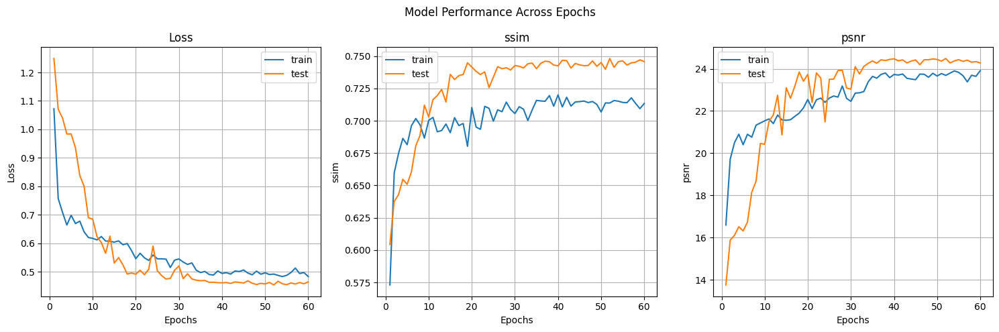

In [9]:
config = {
  "data": {
    "data_path": data_dir,
    "transforms": {
      "HorizontalFlip": {
        "p": 0.3
      },
      "RandomBrightnessContrast": {
        "brightness_limit": 0.5,
        "contrast_limit": 0.2,
        "p": 0.2
      },
    }
  },
  "model": {
    "model_name": "segformer",
    "encoder_name": "efficientnet-b3",
    "encoder_weights": "imagenet",
    "in_channels": 3,
    "classes": 3,
    "activation": "sigmoid",
    "decoder_attention_type": "scse"
  },
  "training": {
    "output_path": "/content/drive/MyDrive/AppNation_CaseStudy/models/experiment3/",
    "device": "cuda",
    "num_epochs": 300,
    "early_stop_patience": 8,
    "metric_list": ["ssim", "psnr"],
    "dataloader_args": {
      "batch_size": 4,
      "num_workers": 2,
    },
    "criterion_args": {
      "l1_loss": {"weight": 5},
      "perceptual_loss": {
        "weight": 1,
        "perceptual_net": "vgg"
      },
    },
    "optimizer_args":{
      "lr": 0.001,
      "weight_decay": 5e-3,
    },
    "scheduler_args": {
      "patience": 4,
      "factor": 0.1,
    },
  }
}
model = train_model(config)

In [10]:
metrics = test_model(model, config)
print("\nEvaluation Results:")
print(f"SSIM: {metrics['ssim_mean']:.4f} ± {metrics['ssim_std']:.4f}")
print(f"PSNR: {metrics['psnr_mean']:.4f} ± {metrics['psnr_std']:.4f}")
print(f"Perceptual: {metrics['perceptual_mean']:.4f} ± {metrics['perceptual_std']:.4f}")
print(f"L1: {metrics['l1loss_mean']:.4f} ± {metrics['l1loss_std']:.4f}")

  0%|                                                                   | 0/6 [00:00<?, ?it/s]

Setting up [LPIPS] perceptual loss: trunk [vgg], v[0.1], spatial [off]


/usr/local/lib/python3.11/dist-packages/torchvision/models/_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=VGG16_Weights.IMAGENET1K_V1`. You can also use `weights=VGG16_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)
/usr/local/lib/python3.11/dist-packages/lpips/lpips.py:107: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-mod

Loading model from: /usr/local/lib/python3.11/dist-packages/lpips/weights/v0.1/vgg.pth


100%|███████████████████████████████████████████████████████████| 6/6 [00:03<00:00,  1.63it/s]


Evaluation Results:
SSIM: 0.7425 ± 0.0415
PSNR: 24.4040 ± 0.6840
Perceptual: 0.2846 ± 0.0288
L1: 0.0353 ± 0.0059


#### Sample Recon Visualization

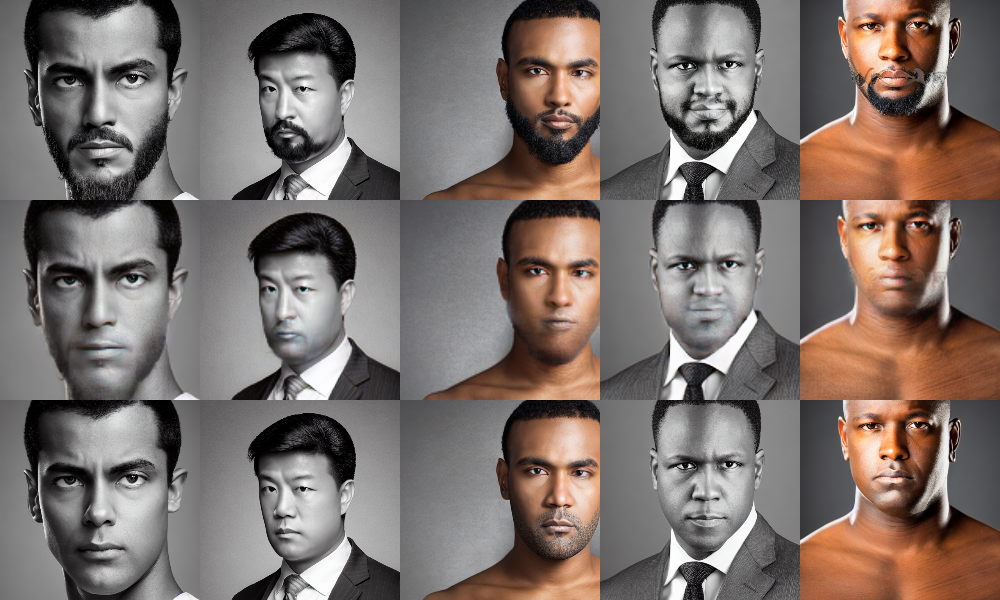

In [11]:
from utils import post_process
from dataset import create_dataloader

loader = create_dataloader(os.path.join(data_dir, "test"), batch_size=5, shuffle=True)
x, y = next(iter(loader))
x = x.to(device)
generated = model(x).detach().cpu()
processed_x = side_by_side(post_process(x, False), 1)
processed_x_gen = side_by_side(post_process(generated, False), 1)
processed_y = side_by_side(post_process(y, False), 1)
side_by_side([processed_x, processed_x_gen, processed_y], 0)